In [1]:
import cv2
from matplotlib import pyplot as plt

importing Image

In [3]:
image_file = "C:\\Users\\mh183\\OneDrive\\Pictures\\page_01.jpg"
img = cv2.imread(image_file)

In [4]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)
    if len(im_data.shape) == 3:
        height, width, depth = im_data.shape
    else:  # For grayscale images
        height, width = im_data.shape
        depth = 1  # You can assume depth as 1 for grayscale
    figsize = width / float(dpi), height / float(dpi)
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0,0,1,1])
    ax.axis('off')
    ax.imshow(im_data, cmap='gray')
    plt.show()

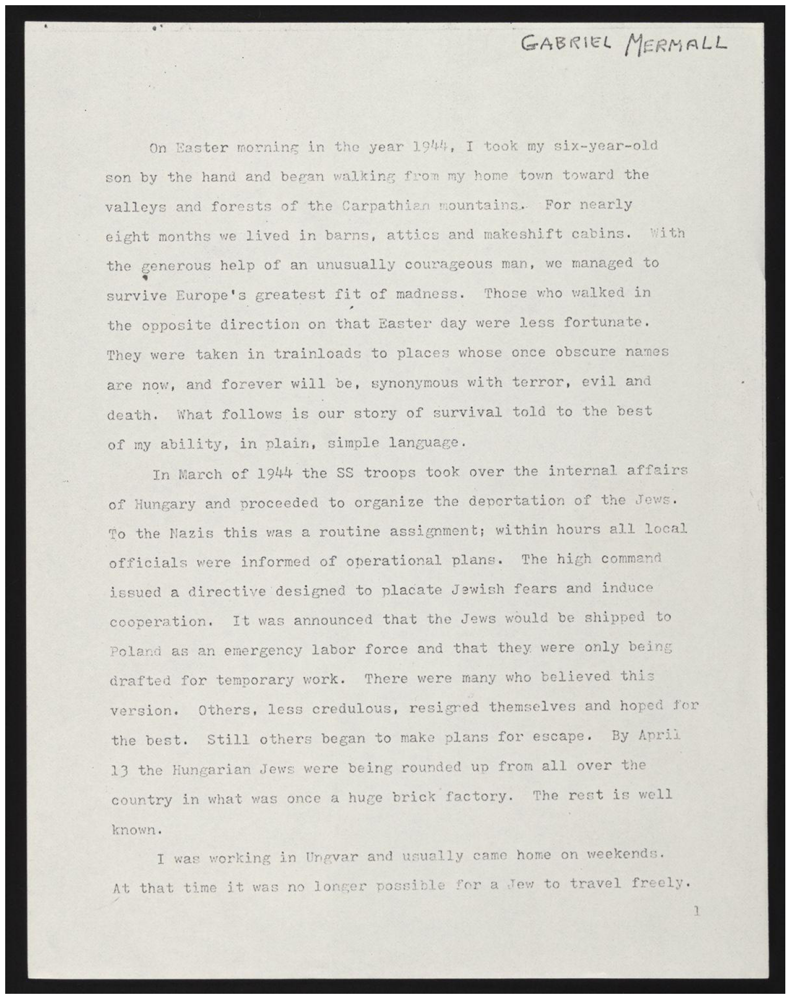

In [5]:
display(image_file)

Inverted Image

In [7]:
inverted_image = cv2.bitwise_not(img)
cv2.imwrite("temp/inverted.jpg",inverted_image)

True

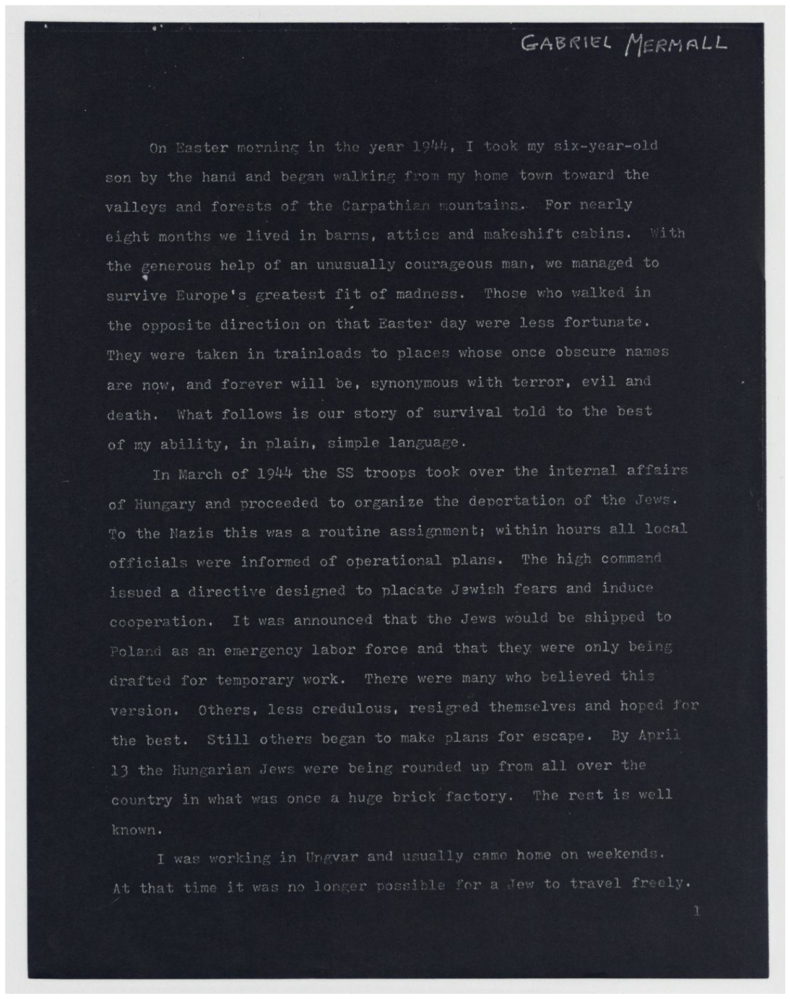

In [8]:
display("temp/inverted.jpg")

Rescaling

Binarization

In [11]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [12]:
gray_image = grayscale(img)
cv2.imwrite("temp/gray.jpg", gray_image)

True

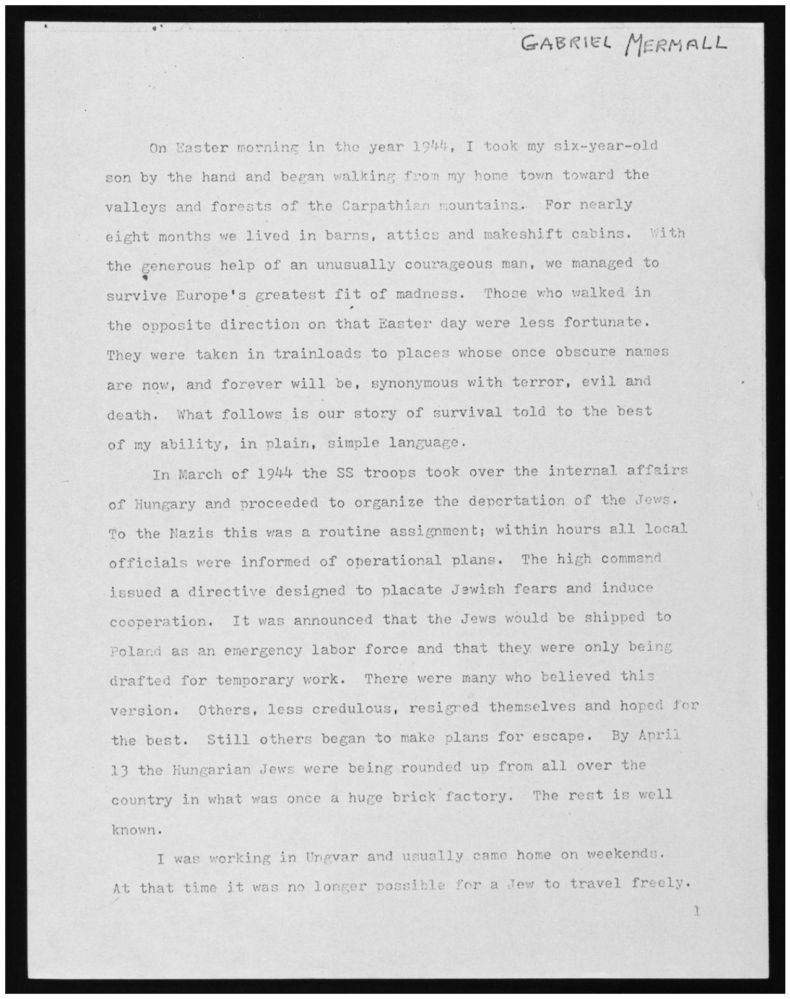

In [13]:
display("temp/gray.jpg")

In [14]:
thresh, im_bw = cv2.threshold(gray_image, 200, 230, cv2.THRESH_BINARY)
cv2.imwrite("temp/bw_image.jpg", im_bw)

True

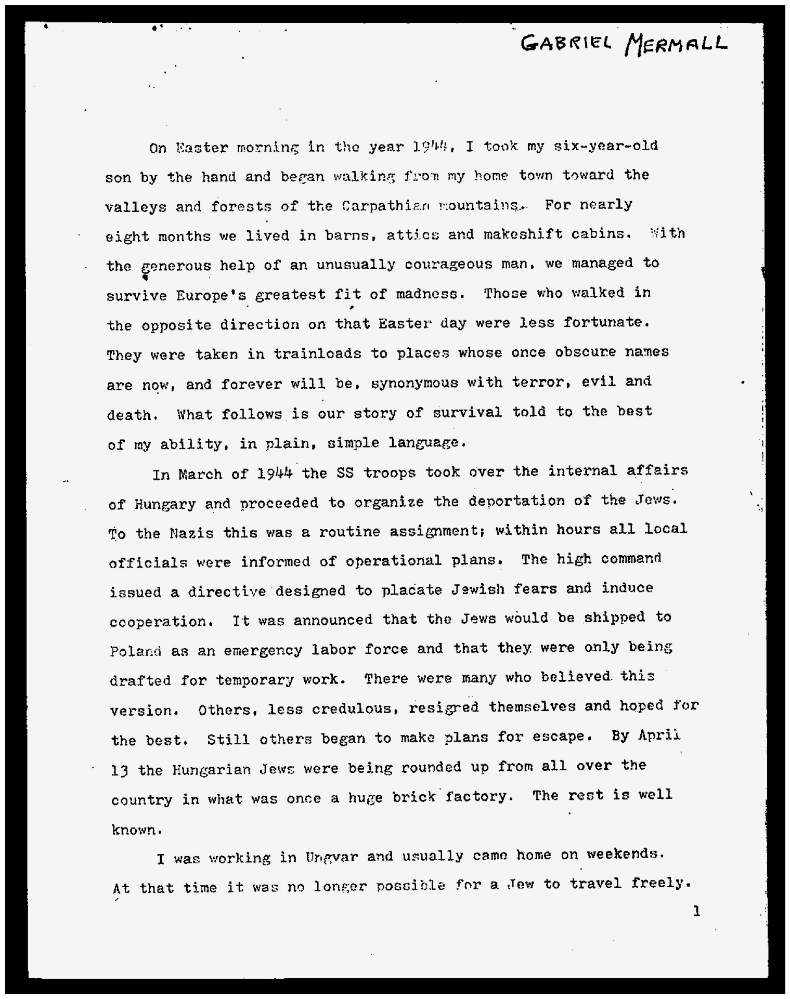

In [15]:
display("temp/bw_image.jpg")

Noise Removal

In [17]:
def noise_removal(image):
    import numpy as np
    kernel = np.ones((1,1),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return(image)

In [18]:
no_noise = noise_removal(im_bw)
cv2.imwrite("temp/no_noise.jpg", no_noise)

True

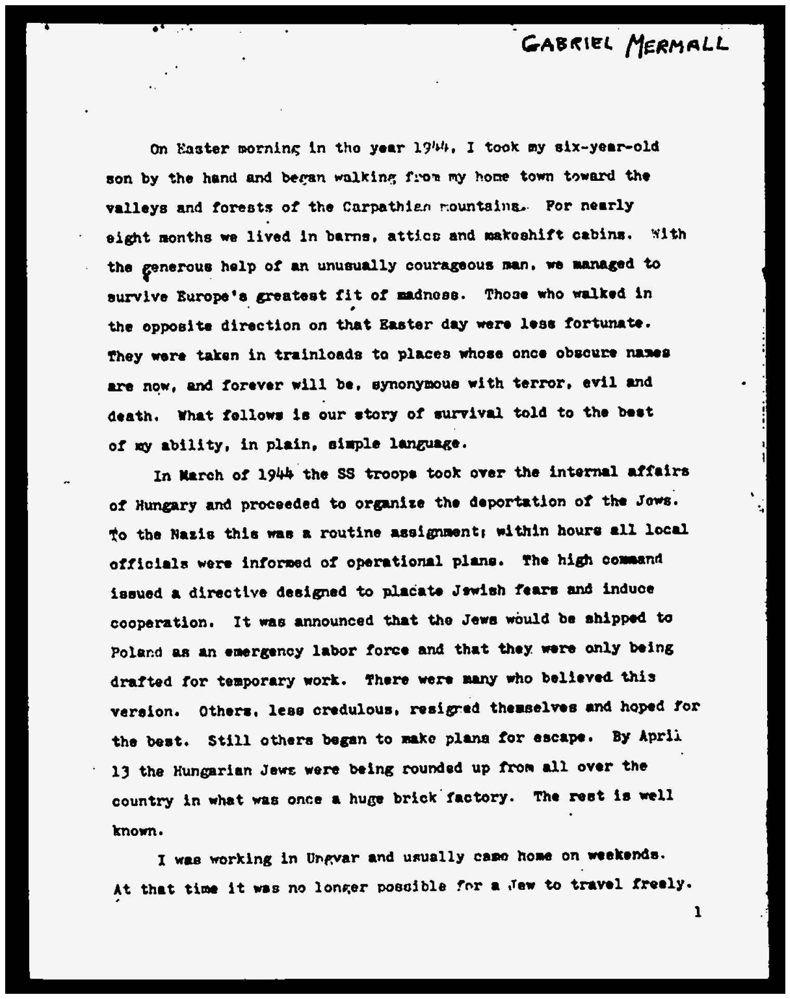

In [19]:
display("temp/no_noise.jpg")

Dilation and Erosion

In [21]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations = 1)
    image = cv2.bitwise_not(image)
    return(image)

In [22]:
eroded_image = thin_font(no_noise)
cv2.imwrite("temp/eroded_image.jpg",eroded_image)

True

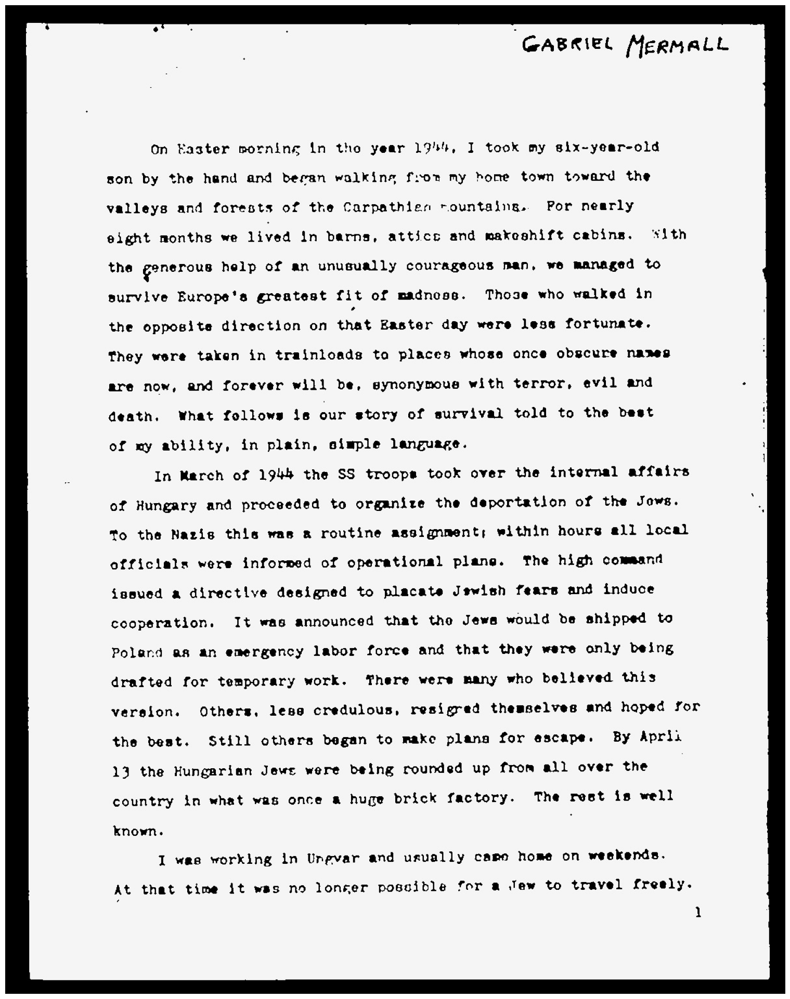

In [23]:
display("temp/eroded_image.jpg")

In [24]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations = 1)
    image = cv2.bitwise_not(image)
    return(image)

In [25]:
dilated_image = thick_font(no_noise)
cv2.imwrite("temp/dilated_image.jpg",dilated_image)

True

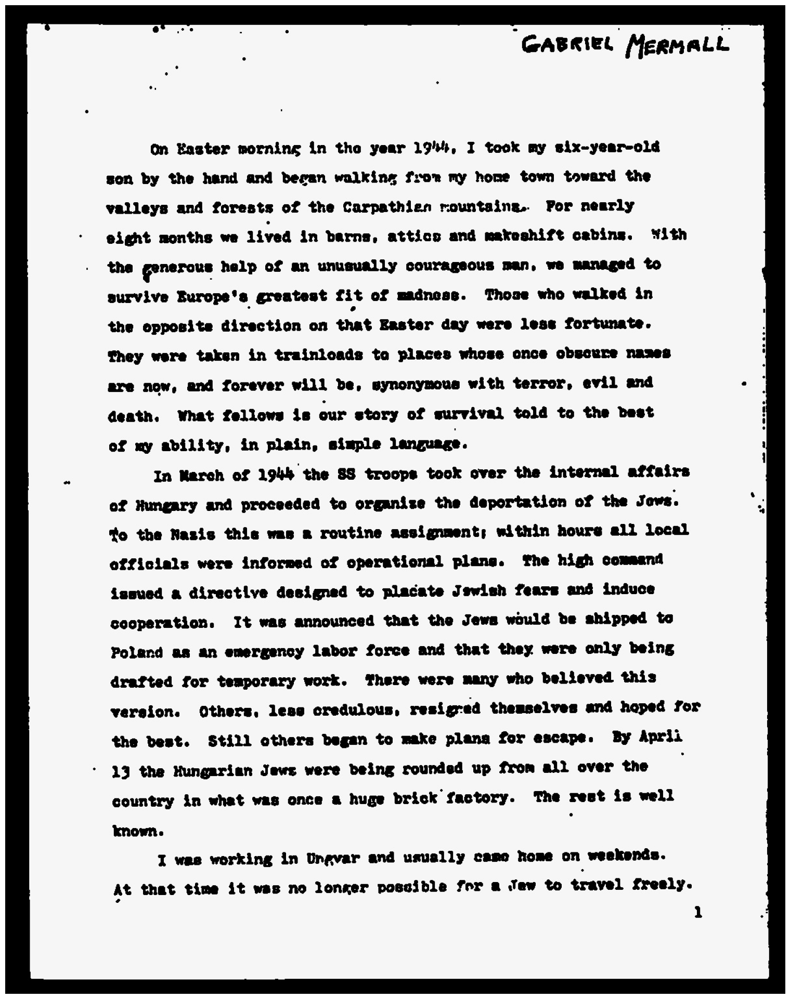

In [26]:
display("temp/dilated_image.jpg")

Rotation/ Deskewing

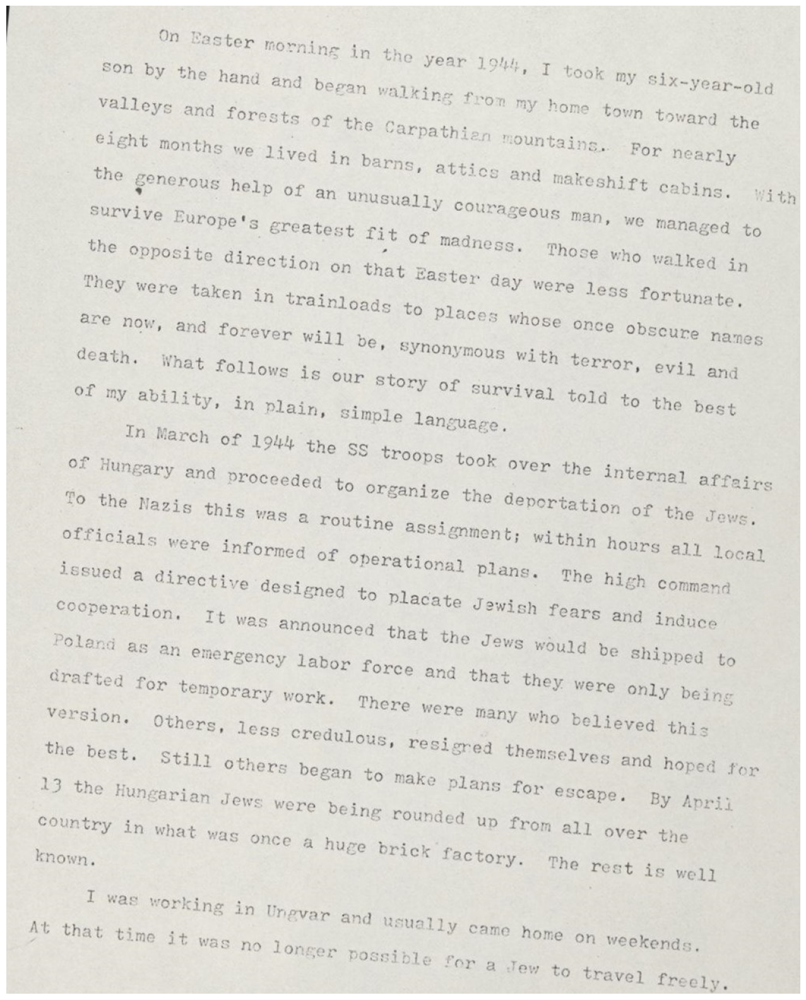

In [41]:
new = cv2.imread("C:\\Users\\mh183\\OneDrive\\Pictures\\page_01_rotated.JPG")
display("C:\\Users\\mh183\\OneDrive\\Pictures\\page_01_rotated.JPG")

In [79]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray,(9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    # Apply dilate to merge text into meaningfull line/paragraphs.
    # Use larger kernel on x axis to merge characters into single line, cnacelling out any spaces
    # Use smaller kernel on y axis to seperate between different blacks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations =2)
    
    #Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find Largest contours and surround in min area box
    largestContour = contours[0]
    print(len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle, Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [81]:
# deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [83]:
fixed = deskew(new)
cv2.imwrite("temp/rotated_fixed.jpg", fixed)

28


True

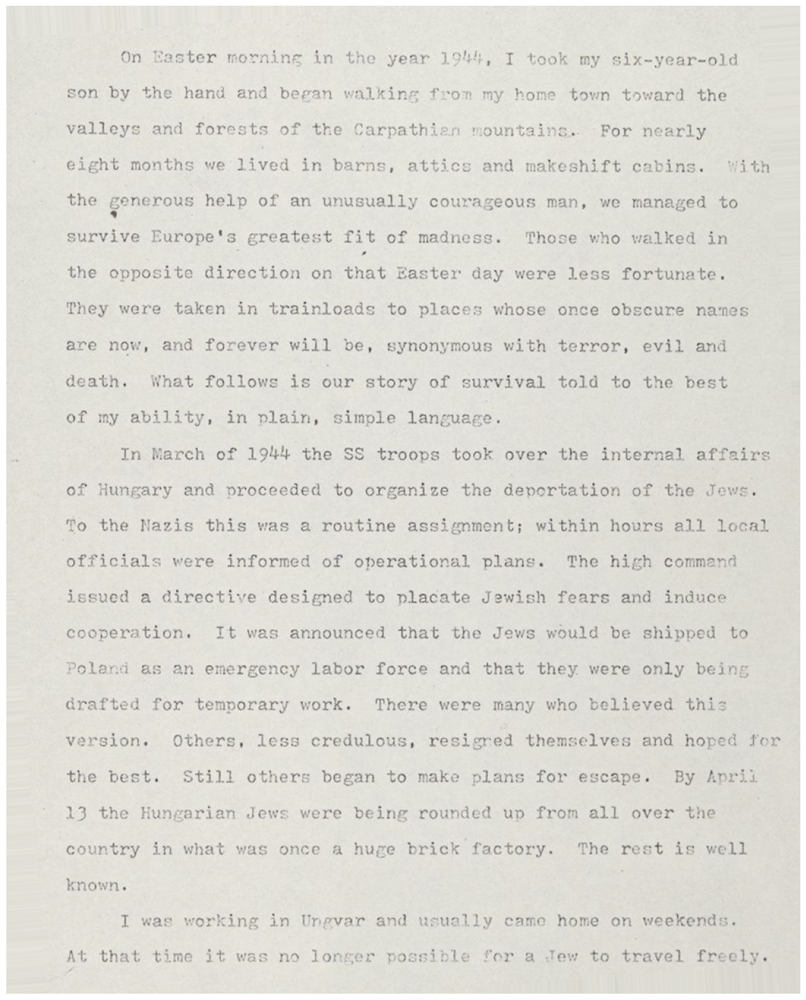

In [85]:
display("temp/rotated_fixed.jpg")

Removing Border

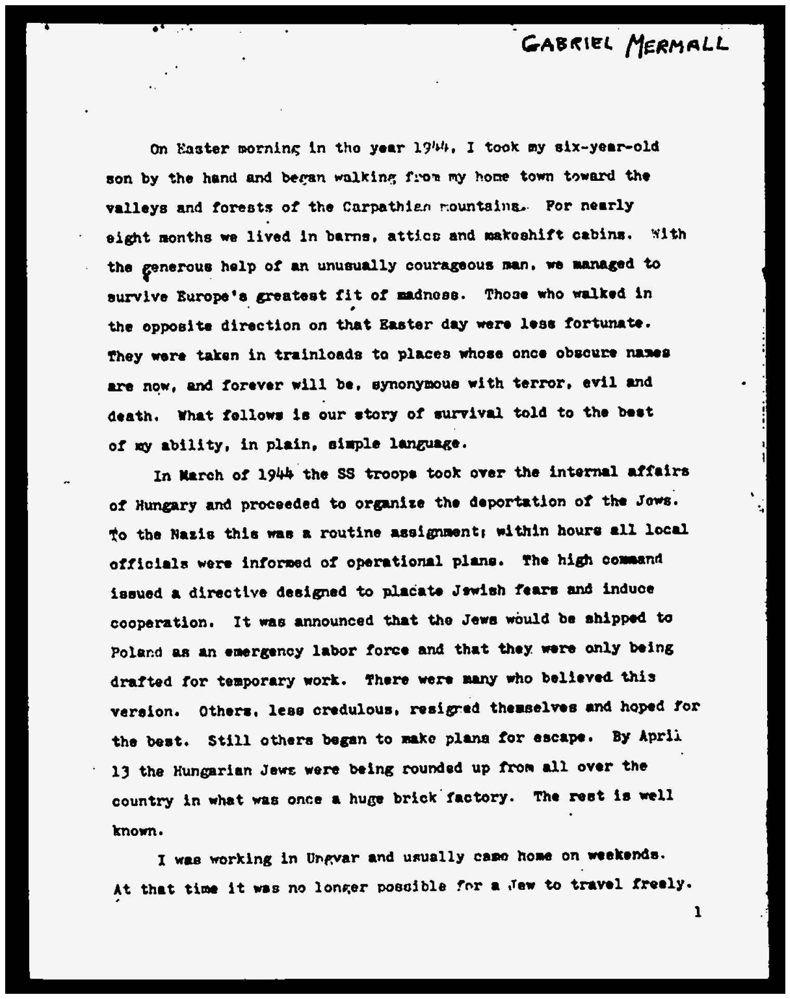

In [88]:
display("temp/no_noise.jpg")

In [90]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

In [92]:
no_borders = remove_borders(no_noise)
cv2.imwrite("temp/no_borders.jpg", no_borders)

True

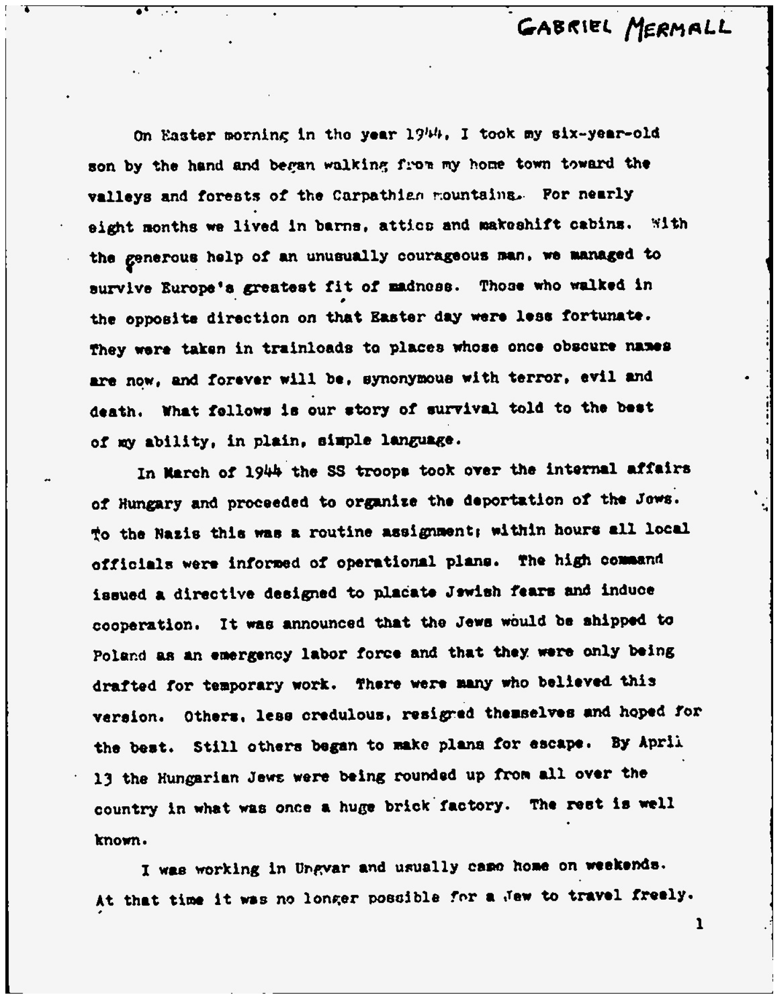

In [94]:
display("temp/no_borders.jpg")

Missing Border

In [97]:
color = [255, 255, 255]
top, bottom, left, right = [150]*4

In [105]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right ,cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("temp/image_with_border.jpg", image_with_border)

True

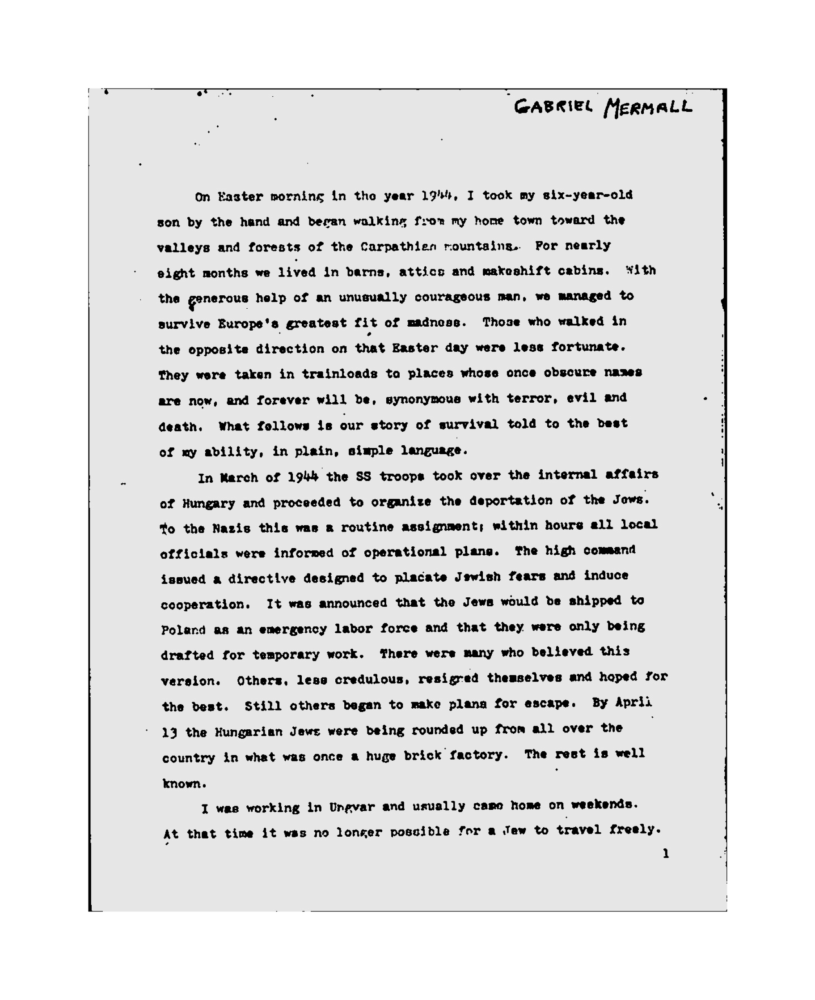

In [107]:
display("temp/image_with_border.jpg")

Transparency/ Alpha Channel

In [124]:
def add_transparency(cvImage, alpha_value=128):
    # to add alpha channel(transparency) to an image
    # Get dimension of the image
    h, w = cvImage.shape[:2]
    # create an alpha channel with the same dimension, filled with the specified alpha value
    alpha_channel = np.full((h, w), alpha_value, dtype=cvImage.dtype)
    # Add the alpha channel to the BGR image to make it BGRA
    bgra_image = cv2.merge([cvImage, alpha_channel])
    return bgra_image

In [126]:
image_path = 'temp/no_noise.jpg'
image = cv2.imread(image_path)

In [128]:
# Add transparency with an alpha value of (50% transparency)
transparent_image = add_transparency(image, alpha_value=128)
cv2.imwrite("temp/transparent_image.png", transparent_image)

True

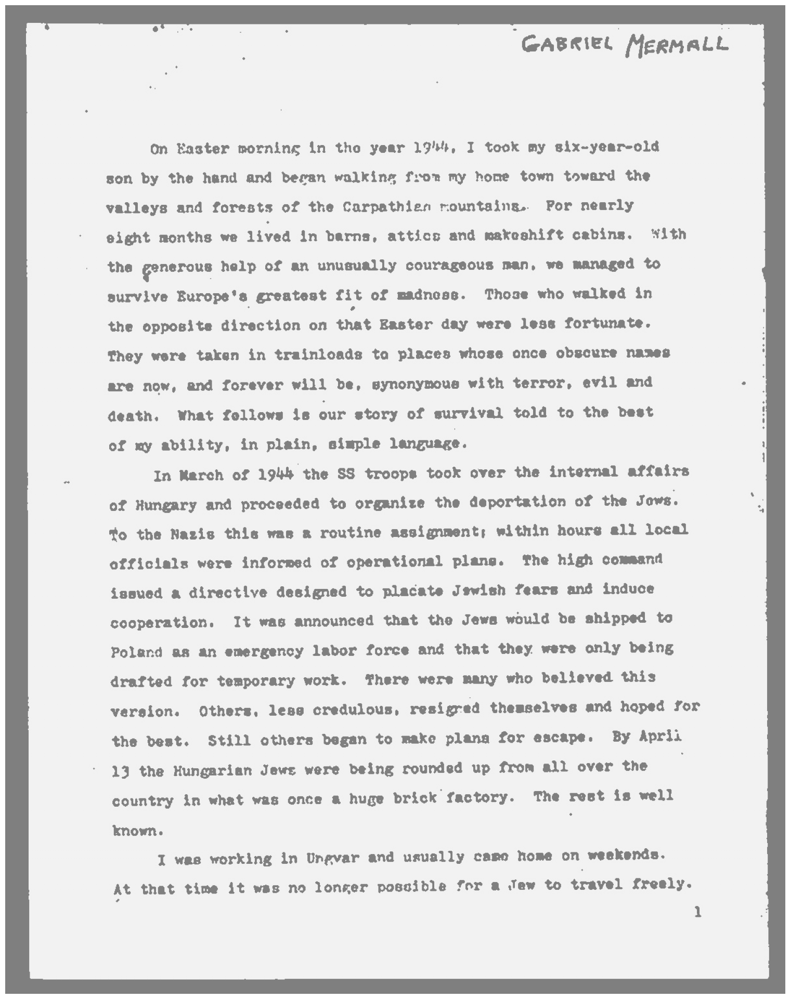

In [132]:
display("temp/transparent_image.png")